In [1]:
import pandas as pd
import seaborn as sns
import plotly
import plotly.express as px
plotly.offline.init_notebook_mode(connected=True)

# Datasets

In [5]:
DE__WT_33__drh_3_mutant_33_path = "../results/DE__WT_33__drh_3_mutant_33/DE_edgeR/salmon_quant_reads/final_table_with_transposons.tsv"
DE__WT_33__dpf_3S784A_33_path = "../results/DE__WT_33__dpf_3S784A_33/DE_edgeR/salmon_quant_reads/final_table_with_transposons.tsv"
DE__WT_33__dpf_3_delta_33_path = "../results/DE__WT_33__dpf_3_delta_33/DE_edgeR/salmon_quant_reads/final_table_with_transposons.tsv"

# Functions

In [8]:
def ma_plot(path, title):
    df = pd.read_csv(path, header=0, sep="\t")
    df.loc[df["transposon"].isna(), "transposon"] = "No info"
    df.loc[df["transposon_family"].isna(), "transposon_family"] = "No info"
    df["transposon_overlap"] = "No"
    df.loc[~(df["transposon"]=="No info"), "transposon_overlap"] = "Yes"
    
    df["Mark"] = "All genes"
    df.loc[df["FDR"]<0.05, "Mark"] = "FDR<0.05"
    df.loc[(df["FDR"]<0.05) & (df["transposon_overlap"]=="No"), "Mark"] = "FDR<0.05\nNo transposon overlap"
    df.loc[(df["FDR"]<0.05) & (df["transposon_overlap"]=="Yes"), "Mark"] = "FDR<0.05\nTransposon overlap"
    
    fig = px.scatter(df,
                 x="logCPM",
                 y="logFC",
                 color="Mark",
                 hover_name="id",
                 hover_data=["id", "gene_biotype", "transposon", "transposon_family", "FDR", "Mark"],
                 title = title,
                 width=1024, height=1024)
    fig.show()

# Results

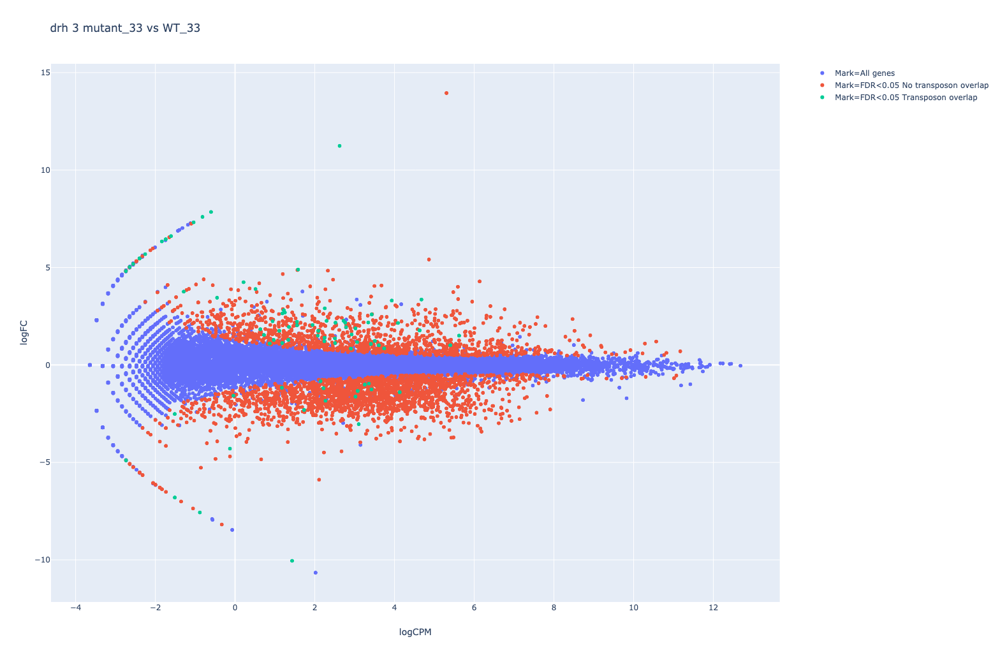

In [9]:
ma_plot(DE__WT_33__drh_3_mutant_33_path, "drh 3 mutant_33 vs WT_33")

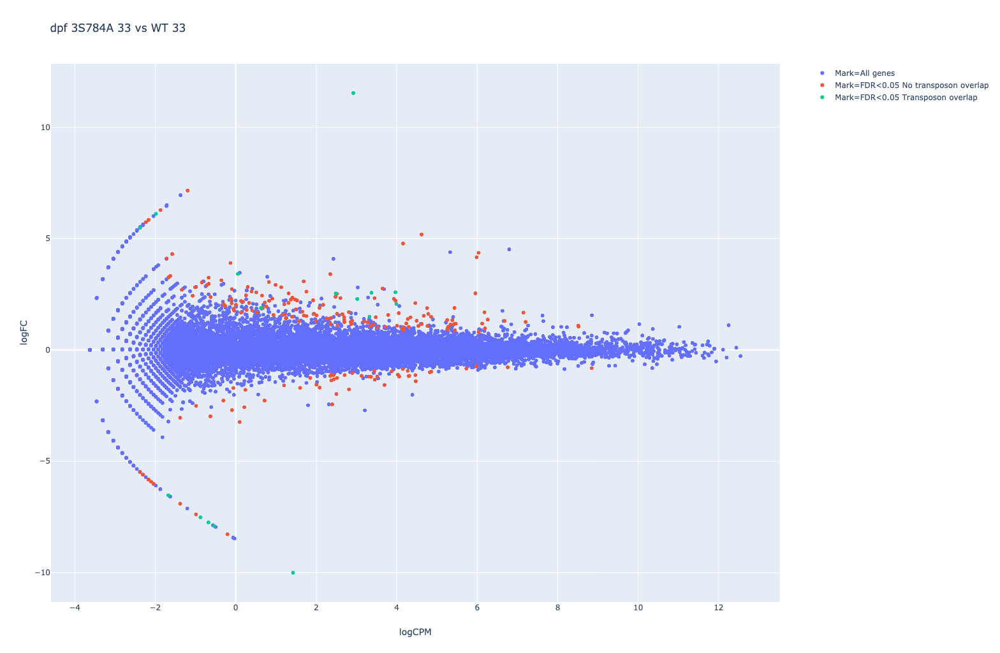

In [10]:
ma_plot(DE__WT_33__dpf_3S784A_33_path, "dpf 3S784A 33 vs WT 33")

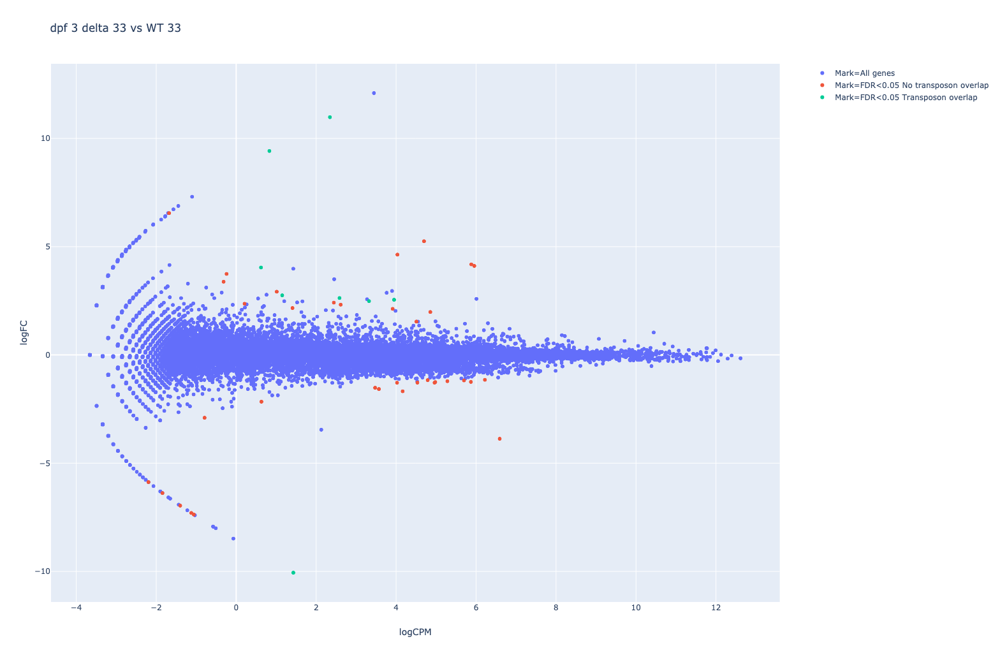

In [11]:
ma_plot(DE__WT_33__dpf_3_delta_33_path, "dpf 3 delta 33 vs WT 33")